<a href="https://colab.research.google.com/github/lucas-azdias/Coin-Recognition/blob/main/Coin%20Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Graded Assignment #1: Coin Recognition using Shallow and Deep Learning**

---

## **Team Members**




* Guilherme Henrique de Lara Peres
* Henrique Anderle Schulz
* Lucas Azevedo Dias
* Pedro Lucas Ghezzi Bittencourt
* Rafaela de Miranda
* Victor Portelinha

---

## **Objective and Guidelines**




Develop and evaluate methodologies for coin segmentation and recognition in images, comparing shallow and deep learning approaches, and provide a critical analysis of the effectiveness of each method.

You must code your solution using this template, following the section structure to ensure an efficient grading and provision of feedback process.

A good rationale is to alternate code and text cells to explain the motivation behind each implementation step.



### **Assignment Guidelines:**


* Groups must also be organized in the institutional virtual environment (AVA) under the tab **Pessoas →  Grupos Disciplina**. Groups outside this structure will not be accepted.

* Submissions must be performed through AVA. Deadlines will be defined in the assignment post on AVA.

* Deliverables: This Jupyter Notebook containing the assignment solution.

* The Jupyter Notebook must be fully executable without requiring manual setup (e.g., parameter configuration, data path definition, or dataset upload).

* Evaluation rubrics will be available in the AVA.

* This graded assignment also counts as part of the ‘TDE’ hours.




**Disclaimer**: Any form of copying or plagiarism, including content generated by AI tools, may result in the annulment of the assignment and a score of zero.

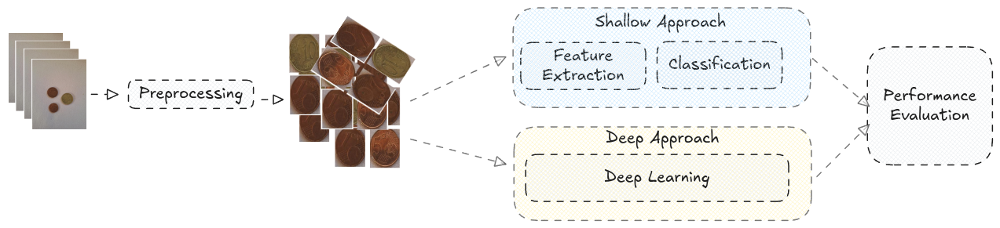

# **Imports**

## **Downloading**

In [ ]:
!apt-get update -qq
!apt-get install -y fonts-dejavu > /dev/null 2>&1

W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)


## **Importing...**

In [ ]:
import cv2
import itertools
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import skimage
import sklearn
import tensorflow as tf

from PIL import Image, ImageDraw, ImageFont

## **Configurations**

In [ ]:
font_size = 64
font = ImageFont.truetype("DejaVuSans.ttf", font_size)

# **The Dataset**

## **Retrieving the Dataset**

### **Downloading the Dataset**

In [ ]:
# !wget -O /content/EuroCoins.zip https://github.com/andrehochuli/teaching/raw/refs/heads/main/datasets/EuroCoinsWihoutLabels.zip

dataset_path = "/content/EuroCoins"

!rm -rf "{dataset_path}"
!mkdir -p "{dataset_path}"
!curl -L -o "{dataset_path}/EuroCoins.zip" https://www.kaggle.com/api/v1/datasets/download/janstaffa/euro-coins-dataset
!unzip -qo "{dataset_path}/EuroCoins.zip" -d "{dataset_path}"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 10.6M  100 10.6M    0     0  13.6M      0 --:--:-- --:--:-- --:--:-- 13.6M


### **Adjusting the Dataset**

In [ ]:
classes = {
    0: "1¢",
    1: "2¢",
    2: "5¢",
    3: "10¢",
    4: "20¢",
    5: "50¢",
    6: "1€",
    7: "2€",
}

In [ ]:
images_path = f"{dataset_path}/images"
labels_path = f"{dataset_path}/labels"

image_files = [f for f in os.listdir(images_path) if f.endswith(".jpg")]
image_files.sort()

label_files = [f for f in os.listdir(labels_path) if f.endswith(".txt")]
label_files.sort()

In [ ]:
images = []
labels = []

for image_file, label_file in zip(image_files, label_files):
    img_path = os.path.join(images_path, image_file)
    label_path = os.path.join(labels_path, label_file)

    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            img_label = []
            for line in f.readlines():
                parts = line.strip().split()
                if len(parts) == 5:
                    class_id, x_center, y_center, w, h = map(float, parts)
                    img_label.append((int(class_id), x_center, y_center, w, h))
            labels.append(img_label)

    images.append(img_path)

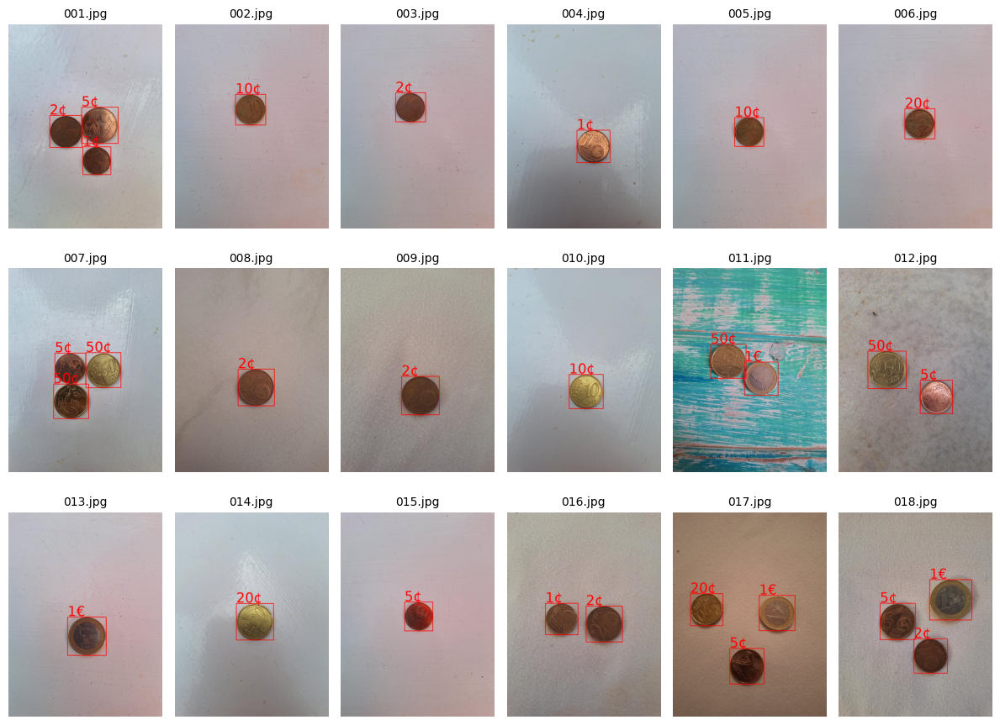

In [ ]:
images_per_row = 6
images_row = 3

max_images = images_per_row * images_row

plt.figure(figsize=(images_per_row * 2, images_row * 3))

for i, (img_path, img_labels) in enumerate(zip(images, labels)):
    if i >= max_images:
        break

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for label in img_labels:
        class_id, x_center, y_center, w, h = label

        h_img, w_img = img.shape[:2]

        # Convert normalized coordinates
        x_center *= w_img
        y_center *= h_img
        w *= w_img
        h *= h_img

        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        # Draw rectangle and bigger text
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
        class_name = classes[class_id] if class_id < len(classes) else str(class_id)
        img_pil = Image.fromarray(img)
        ImageDraw.Draw(img_pil).text((x1, y1 - font_size), class_name, font=font, fill=(255, 0, 0))
        img = np.array(img_pil)

    # Display in grid
    plt.subplot(images_row, images_per_row, i + 1)
    plt.imshow(img)
    plt.title(image_files[i], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

## **Normalizing the Data**

In [ ]:
input_shape = (720, 960, 3) # Width, Height, Channels

In [ ]:
def preprocess_image(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img).astype(np.uint8)

    # Resize to input shape
    img = cv2.resize(img, input_shape[:2], interpolation=cv2.INTER_AREA)

    return img

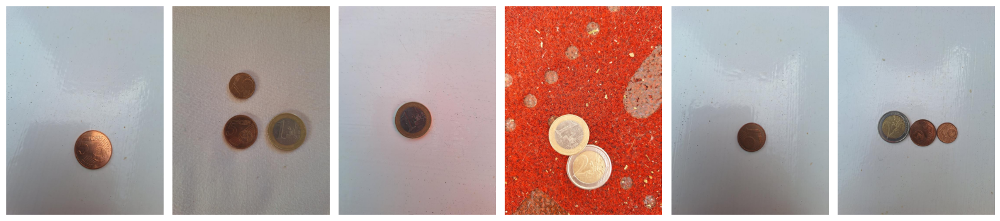

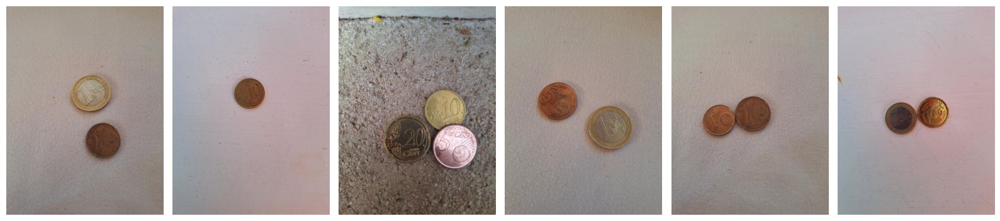

In [ ]:
loaded_images = [preprocess_image(img_path) for img_path in images]

for _ in range(2):
    # Pick 10 random indices
    random_idxs = np.random.choice(len(loaded_images), size=6, replace=False)

    # Plot side by side
    fig, axes = plt.subplots(1, 6, figsize=(16, 10))
    for ax, mask in zip(axes, random_idxs):
        ax.imshow(loaded_images[mask])
        ax.set_axis_off()
    plt.tight_layout()
    plt.show()

# **Pre-Processing**




* Data Augmentation: Employ augmentation techniques to improve class balance and representation.

* Coin Segmentation: Apply image processing techniques to segment individual coins.

In [ ]:
input_shape = (64, 64, 3)

## **Data augmentation**

### **Initial analysis**

{'1¢': 41, '2¢': 51, '5¢': 56, '10¢': 32, '20¢': 50, '50¢': 27, '1€': 51, '2€': 28}


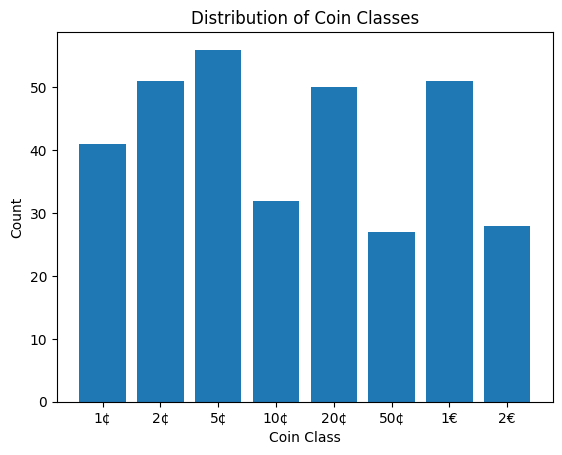

In [ ]:
classes_count = {class_id: 0 for class_id in classes.values()}

for img_labels in labels:
    for class_id, _, _, _, _ in img_labels:
        classes_count[classes[class_id]] += 1

print(classes_count)

plt.bar(list(classes_count.keys()), list(classes_count.values()))
plt.xlabel("Coin Class")
plt.ylabel("Count")
plt.title("Distribution of Coin Classes")
plt.show()

### **Augmentation**

In [ ]:
def crop_coin(img, label):
    h_img, w_img = img.shape[:2]

    x_c, y_c, w, h = label
    x_center = int(x_c * w_img)
    y_center = int(y_c * h_img)
    width = int(w * w_img)
    height = int(h * h_img)

    x1 = max(0, x_center - width // 2)
    y1 = max(0, y_center - height // 2)
    x2 = min(w_img, x_center + width // 2)
    y2 = min(h_img, y_center + height // 2)

    coin_crop = img[y1:y2, x1:x2].copy()

    return coin_crop

In [ ]:
def augment_coin(img, rotation, brightness, image_size):
    aug_coin = tf.convert_to_tensor(img, dtype=tf.float32)

    # Add batch dimension
    aug_coin = tf.expand_dims(aug_coin, 0)

    # Apply rotation
    rotation_layer = tf.keras.layers.RandomRotation(
        factor=(-rotation, rotation),
        fill_mode="nearest"
    )
    aug_coin = rotation_layer(aug_coin,  training=True)[0]

    # Apply brightness adjustment
    aug_coin = tf.image.random_brightness(aug_coin, max_delta=brightness)

    # Clip back to [0, 255]
    aug_coin = tf.clip_by_value(aug_coin, 0, 255)

    # Convert to uint8
    aug_coin = tf.cast(aug_coin, tf.uint8)

    return aug_coin.numpy()

In [ ]:
def normalize_coin(img, image_size):
    # Ensure numpy array
    normalized_coin = np.array(img, copy=True)

    # Resize to fixed size
    h, w = image_size
    normalized_coin = cv2.resize(normalized_coin, (w, h))

    # Normalize to [0,1] float32
    normalized_coin = normalized_coin.astype(np.float32) / 255.0

    return normalized_coin

In [ ]:
def random_oversample(images, labels, amount, image_size):
    # Build class -> list of (img_idx, coin_label)
    class_map = {}
    for img_idx, img_labels in enumerate(labels):
        for label in img_labels:
            class_id = label[0]
            class_map.setdefault(class_id, []).append((img_idx, label))

    # Determine target count
    class_counts = {cls: len(items) for cls, items in class_map.items()}
    max_count = max(class_counts.values())
    target_count = max_count + amount

    new_images, new_labels = [], []

    # Add originals
    for cls, items in class_map.items():
        for img_idx, label in items:
            cropped_coin = crop_coin(images[img_idx], label[1:])
            cropped_coin = normalize_coin(cropped_coin, image_size)
            new_images.append(cropped_coin)
            new_labels.append(label[0])

    for cls, items in class_map.items():
        needed = target_count - len(items)

        # Shuffle items to avoid repetition until all have been used
        pool = items.copy()
        random.shuffle(pool)
        pool_idx = 0

        for _ in range(needed):
            img_idx, label = pool[pool_idx]
            pool_idx += 1

            # Refill & reshuffle pool when exhausted
            if pool_idx >= len(pool):
                pool_idx = 0
                random.shuffle(pool)

            img = images[img_idx]
            cropped_coin = crop_coin(img, label[1:])

            aug_coin = augment_coin(cropped_coin, rotation=0.5, brightness=0.1, image_size=image_size)
            aug_coin = normalize_coin(aug_coin, image_size)
            # plt.imshow(cropped_coin)
            # plt.show()

            new_images.append(aug_coin)
            new_labels.append(label[0])

    # Shuffle at the end to mix originals + augmented
    combined = list(zip(new_images, new_labels))
    random.shuffle(combined)
    new_images, new_labels = zip(*combined)

    return np.array(list(new_images)), np.array(list(new_labels))

In [ ]:
bonus_amount = 534
data_X, data_y = random_oversample(loaded_images, labels, bonus_amount, input_shape[:2])

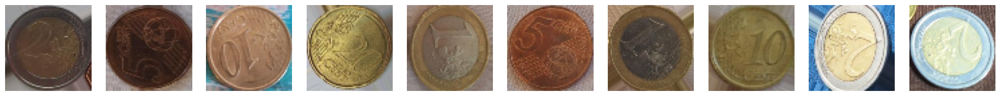

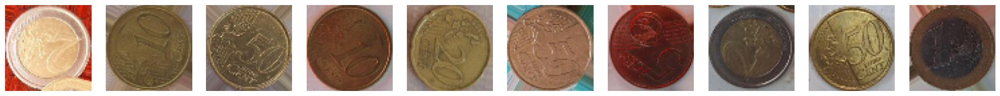

In [ ]:
for _ in range(2):
    # Pick 10 random indices
    random_idxs = np.random.choice(len(data_X), size=10, replace=False)

    # Plot side by side
    fig, axes = plt.subplots(1, 10, figsize=(20, 2))
    for ax, mask in zip(axes, random_idxs):
        ax.imshow(data_X[mask])
        ax.set_axis_off()
    plt.tight_layout()
    plt.show()

### **Checking final distribution**

{'1¢': 590, '2¢': 590, '5¢': 590, '10¢': 590, '20¢': 590, '50¢': 590, '1€': 590, '2€': 590}


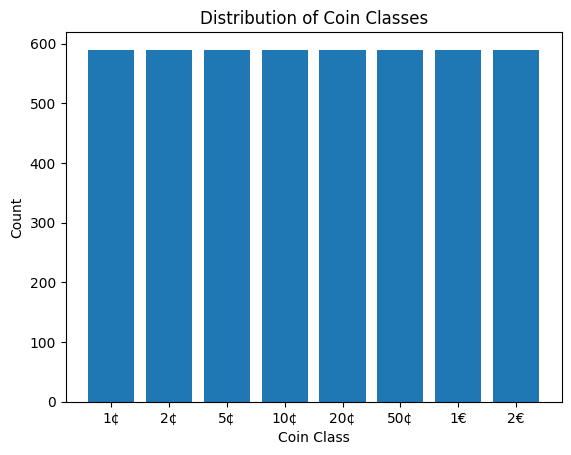

In [ ]:
classes_count = {class_id: 0 for class_id in classes.values()}

for class_id in data_y:
    classes_count[classes[class_id]] += 1

print(classes_count)

plt.bar(list(classes_count.keys()), list(classes_count.values()))
plt.xlabel("Coin Class")
plt.ylabel("Count")
plt.title("Distribution of Coin Classes")
plt.show()

## **Coin segmentation**

### **Segmentation function**

In [ ]:
def segment_coins(img, j):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    gray = cv2.normalize(gray, gray, 0, 255, cv2.NORM_MINMAX)

    # plt.imshow(gray, cmap="gray")
    # plt.show()

    # Adjusts contrast in small regions (make the image more uniform)
    gray = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8)).apply(gray)

    blur = cv2.bilateralFilter(gray, d=11, sigmaColor=75, sigmaSpace=50)
    blur = cv2.edgePreservingFilter(blur, flags=cv2.RECURS_FILTER, sigma_s=20, sigma_r=0.1)

    # Apply Gaussian blur to reduce noise
    blur = cv2.medianBlur(blur, ksize=11)

    # Adaptive threshold to create a binary mask
    thresh = cv2.adaptiveThreshold(
        blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 11, 8
    )

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    gradient = cv2.morphologyEx(thresh, cv2.MORPH_GRADIENT, kernel)
    thresh = cv2.addWeighted(thresh, 1, gradient, 2, 0)

    kernel = np.ones((3, 3), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

    kernel = np.ones((3, 3), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

    kernel = np.ones((3, 3), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_ERODE, kernel)

    # plt.imshow(thresh, cmap="gray_r")
    # plt.show()

    # Supondo que thresh seja uma imagem binária (0 e 255)
    num_labels, comp_labels, stats, centroids = cv2.connectedComponentsWithStats(thresh, connectivity=8)

    min_size = 350  # número mínimo de pixels para manter

    # Cria uma máscara nova só com componentes grandes
    mask = np.zeros_like(thresh, dtype=np.uint8)

    for i in range(1, num_labels):  # pula o background (label 0)
        if stats[i, cv2.CC_STAT_AREA] >= min_size:
            mask[comp_labels == i] = 255

    thresh = mask

    # Remove small contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contour_size_threshold = 10

    for i, contour in enumerate(contours):
        if hierarchy[0][i][3] == -1:  # top-level contour
            x, y, w, h = cv2.boundingRect(contour)
            if not (w > contour_size_threshold and h > contour_size_threshold):
                cv2.drawContours(thresh, [contour], -1, 0, -1)

    thick_thresh = thresh.copy()
    kernel = np.ones((3, 3), np.uint8)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_GRADIENT, kernel)

    white_ratio = cv2.countNonZero(thresh) / thresh.size

    # Detect circles
    circles = cv2.HoughCircles(
        thresh,
        cv2.HOUGH_GRADIENT,
        dp=1.15 if white_ratio < 0.007 else 1.07,
        minDist=100,
        param1=50,
        param2=30,
        minRadius=40,
        maxRadius=150,
    )

    # plt.imshow(thresh, cmap="gray_r")
    # plt.show()

    h_img, w_img = img.shape[:2]
    diameter_threshold = 40
    diameter_bonus = 10

    coins = []

    if circles is not None:
        circles = np.round(circles[0, :, :]).astype(int)

        for (x, y, r) in circles:
            d = 2 * r
            if d > diameter_threshold:
                # bounding box coordinates
                x1 = max(0, x - r - diameter_bonus // 2)
                y1 = max(0, y - r - diameter_bonus // 2)
                x2 = min(w_img, x + r + diameter_bonus // 2)
                y2 = min(h_img, y + r + diameter_bonus // 2)

                roi = thick_thresh[y1:y2, x1:x2]  # cropped binary region
                mask = np.zeros_like(roi, dtype="uint8")
                cv2.circle(mask, (x - x1, y - y1), r, 255, 10)  # filled circle

                total_circle_area = cv2.countNonZero(roi)
                overlap_pixels = cv2.countNonZero(cv2.bitwise_and(roi, mask))

                density = overlap_pixels / max(total_circle_area, 1)

                # filter circles by density threshold
                if density < 0.3:
                    continue

                coins.append(
                    (
                        (x1 + (x2 - x1) / 2) / w_img,  # normalized center x
                        (y1 + (y2 - y1) / 2) / h_img,  # normalized center y
                        (x2 - x1) / w_img,             # normalized width
                        (y2 - y1) / h_img              # normalized height
                    )
                )

    # for coin in coins:
    #     x_center, y_center, w, h = coin
    #     h_img, w_img = img.shape[:2]

    #     # Convert normalized coordinates
    #     x_center *= w_img
    #     y_center *= h_img
    #     w *= w_img
    #     h *= h_img

    #     x1 = int(x_center - w / 2)
    #     y1 = int(y_center - h / 2)
    #     x2 = int(x_center + w / 2)
    #     y2 = int(y_center + h / 2)

    #     cv2.circle(thresh, (int(x_center), int(y_center)), int(w/2), 255, 10)  # filled circle
    #     cv2.rectangle(thresh, (x1, y1), (x2, y2), (255, 0, 0), 2)
    # plt.imshow(thresh, cmap="gray_r")
    # plt.show()

    # if len(coins) != len(labels[j]):
        # plt.subplot(images_row, images_per_row, j + 1)
        # plt.title(f"{image_files[j]} (Coins: {len(coins)} of {len(labels[j])}) {white_ratio*100:.1f}", fontsize=10)
        # plt.imshow(thresh, cmap="gray_r")
        # plt.axis('off')

    return coins

### **Calculating...**

In [ ]:
def iou(boxA, boxB):
    # box = (x1, y1, x2, y2)
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interW = max(0, xB - xA)
    interH = max(0, yB - yA)
    interArea = interW * interH

    if interArea == 0:
        return 0.0

    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    return interArea / float(boxAArea + boxBArea - interArea)

CORRECTLY MATCHED IMAGES: 137/150


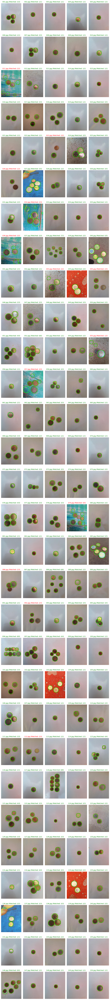

In [ ]:
images_per_row = 5
images_row = 30
max_images = images_per_row * images_row

plt.figure(figsize=(images_per_row * 2, images_row * 3))
correct_segmented_images = 0
matched_segmentations = [[] for _ in range(len(labels))]
all_segmentations = [[] for _ in range(len(labels))]

iou_threshold = 0.5  # minimum overlap to count as correct

for i, img in enumerate(loaded_images):
    if i >= max_images:
        break

    img_processed = img.copy()
    h_img, w_img = img.shape[:2]

    coins = segment_coins(img, i)

    # Convert predicted coins to absolute boxes
    pred_boxes = []
    for coin in coins:
        x_center, y_center, w, h = coin
        x_center *= w_img
        y_center *= h_img
        w *= w_img
        h *= h_img

        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        pred_boxes.append((coin, x1, y1, x2, y2))

        cv2.circle(img_processed, (int(x_center), int(y_center)), int(w/2), (0, 255, 0), 10)
        cv2.rectangle(img_processed, (x1, y1), (x2, y2), (255, 0, 0), 2)

    # Convert labels to absolute boxes
    labels_boxes = []
    for class_id, x_center, y_center, w, h in labels[i]:
        x_center *= w_img
        y_center *= h_img
        w *= w_img
        h *= h_img

        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        labels_boxes.append((class_id, x1, y1, x2, y2))

    # Match predictions to labels (greedy IoU matching)
    matched = 0
    used_preds = set()
    for gt in labels_boxes:
        best_iou = 0
        best_pred = None
        for j, pred in enumerate(pred_boxes):
            if j in used_preds:
                continue
            score = iou(gt[1:], pred[1:])
            if score > best_iou:
                best_iou = score
                best_pred = j

        if best_iou >= iou_threshold and not best_pred is None:
            matched += 1
            used_preds.add(best_pred)
            matched_segmentations[i].append((gt[0], *pred_boxes[best_pred][0]))
            all_segmentations[i].append((gt[0], *pred_boxes[best_pred][0]))

    for j, pred in enumerate(pred_boxes):
        if j not in used_preds:
            all_segmentations[i].append((-1, *pred_boxes[j][0]))

    is_correct = matched == len(labels_boxes) and len(pred_boxes) == len(labels_boxes)

    if is_correct:
        correct_segmented_images += 1

    # Display
    plt.subplot(images_row, images_per_row, i + 1)
    plt.imshow(img_processed)
    plt.title(
        f"{image_files[i]} (Matched: {matched}/{len(labels_boxes)})",
        fontsize=10,
        color="green" if is_correct else "red"
    )
    plt.axis("off")

print(f"CORRECTLY MATCHED IMAGES: {correct_segmented_images}/{max_images}")

plt.tight_layout()
plt.show()

### **Formatting segmentations and augmenting**

In [ ]:
bonus_amount = 45
seg_X, seg_y = random_oversample(loaded_images, matched_segmentations, bonus_amount, input_shape[:2])

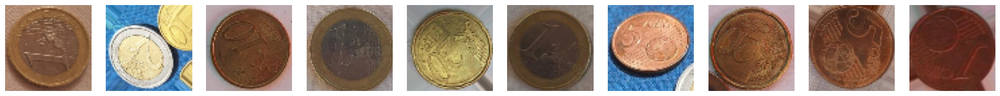

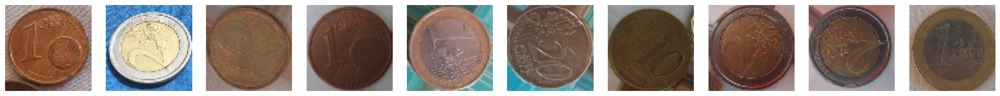

In [ ]:
for _ in range(2):
    # Pick 10 random indices
    random_idxs = np.random.choice(len(seg_X), size=10, replace=False)

    # Plot side by side
    fig, axes = plt.subplots(1, 10, figsize=(20, 2))
    for ax, mask in zip(axes, random_idxs):
        ax.imshow(seg_X[mask])
        ax.set_axis_off()
    plt.tight_layout()
    plt.show()

### **Calculating the segmentation error**

In [ ]:
# Flatten matched and all segmentations
matched_flat = list(itertools.chain.from_iterable(matched_segmentations))
all_flat = list(itertools.chain.from_iterable(all_segmentations))

# Total ground-truth coins
total_gt = sum(len(lbl) for lbl in labels)

# True positives (matched)
num_matched = len(matched_flat)

# False positives (predictions that didn't match any GT)
num_false_positives = sum(1 for seg in all_flat if seg[0] == -1)

# False negatives (ground-truth coins that were not detected)
num_false_negatives = total_gt - num_matched

# Count unmatched predictions
num_unmatched_pred = sum(1 for seg in all_flat if seg[0] == -1)

# Count non-segmented ground-truth coins
num_non_segmented = total_gt - num_matched

# Total segmentation error (normalized)
segmentation_error = (num_unmatched_pred + num_non_segmented) / total_gt

calc_final_acc = lambda acc: acc * (1 - segmentation_error)

print(f"Total coins expected: {total_gt}")
print(f"True Positives (Matched): {num_matched}")
print(f"False Positives (Extra Predictions): {num_false_positives}")
print(f"False Negatives (Non-Segmented GT): {num_false_negatives}")
print(f"Segmentation Error (including missing + extra): {100 * segmentation_error:.2f}%")

Total coins expected: 336
True Positives (Matched): 327
False Positives (Extra Predictions): 26
False Negatives (Non-Segmented GT): 9
Segmentation Error (including missing + extra): 10.42%


# **Classification Approaches**

## **Shallow Learning**





* Feature Extraction: Evaluate at least three distinct methods (e.g., LBP, HOG, color histograms), including at least one combined/fusion descriptor approach.

* Classification Models: Evaluate at least two shallow models (e.g., SVM, Random Forest, KNN).
Compare the performance of different feature-classifier combinations.

* Evaluation Protocol: Use K-FOLD cross-validation with K=3 to ensure robust evaluation and generalization of the models. For the test phase, only real data must be used.

### **Basic functions**

In [ ]:
def extract_features(X, features_extractors):
    features = []
    for i in range(X.shape[0]):
        img_features = []
        for features_extractor in features_extractors:
            fd = features_extractor(np.asarray(X[i] * 255, dtype=np.uint8))
            img_features.append(fd)
        img_features = np.concatenate([np.ravel(fd) for fd in img_features])
        features.append(img_features)
    return np.array(features, dtype=np.float32)

In [ ]:
def shallow_classify(X, y, classes, k_splits, features_extractors, classifier):
    features = extract_features(X, features_extractors)

    # Define KFold
    kfold = sklearn.model_selection.StratifiedKFold(n_splits=k_splits, shuffle=True, random_state=1)

    reports = []

    for fold, (train_idx, test_idx) in enumerate(kfold.split(X, y)):
        # Split data
        X_train, X_test = features[train_idx], features[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        # Train model
        model = classifier()
        model.fit(X_train, y_train)

        # Predict & evaluate
        y_pred = model.predict(X_test)

        # Generate classification report as dict
        report = sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, output_dict=True, zero_division=0)
        reports.append(report)

        print(f"\nFold {fold + 1} classification report:")
        print(sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, zero_division=0))

    # Compute mean scores across folds
    mean_report = {}
    for key in reports[0].keys():  # Iterate over classes + "accuracy", "macro avg", "weighted avg"
        if key == "accuracy":
            mean_report[key] = {
                "precision": "",
                "recall": "",
                "f1-score": f"{np.mean([r[key] for r in reports]):.2f}",
                "support": f"{int(np.mean([r['macro avg']['support'] for r in reports]))}"
            }
        else:
            mean_report[key] = {}
            for metric in reports[0][key]:
                result = np.mean([r[key][metric] for r in reports])
                mean_report[key][metric] = f"{result:.2f}" if metric != "support" else f"{int(result)}"

    # Format like original classification_report
    print("\nMean classification report across folds:")
    print("=" * 56)
    headers = ["precision", "recall", "f1-score", "support"]
    row_fmt = "{:>12} {:>10} {:>10} {:>10} {:>10}".format("", *headers)
    print(row_fmt)

    for key, metrics in mean_report.items():
        if key in ["accuracy", "macro avg", "weighted avg"]:
            if key == "accuracy":
                print()
            print(f"{key:>12} ", end="")
        else:
            print(f"{key:>12} ", end="")
        print("{:10} {:>10} {:>10} {:>10}".format(
            metrics["precision"], metrics["recall"], metrics["f1-score"], metrics["support"]
        ))

In [ ]:
def shallow_evaluate(X_train, y_train, X_test, y_test, classes, features_extractors, classifier):
    # Extract features
    train_features = extract_features(X_train, features_extractors)
    test_features = extract_features(X_test, features_extractors)

    # Train model on full training set
    model = classifier()
    model.fit(train_features, y_train)

    # Predict on test set
    y_pred = model.predict(test_features)

    # Accuracy
    acc = sklearn.metrics.accuracy_score(y_test, y_pred)
    print(f"\nClassification accuracy: {100 * acc:.2f}%")
    print(f"Final accuracy (considering the segmentation error): {100 * calc_final_acc(acc):.2f}%")

    # Classification report
    print("\nClassification Report on Test Set:")
    print(sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, zero_division=0))

    # Confusion matrix
    sklearn.metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_pred, display_labels=classes)
    plt.show()

    # Show correct and wrong predictions
    index = np.random.randint(len(y_test))
    amount = 10
    diff = y_test - y_pred

    masks = [np.where(diff == 0)[0], np.where(diff != 0)[0]]

    for mask in masks:
        valid_indices = mask[mask >= index][:amount]

        _, axes = plt.subplots(nrows=1, ncols=len(valid_indices), figsize=(20, 10))

        if len(valid_indices) == 1:
            axes = [axes]

        for ax, idx in zip(axes, valid_indices):
            ax.set_axis_off()
            ax.imshow(X_test[idx], interpolation="nearest")
            ax.set_title(f"Lbl: {classes[y_test[idx]]} Pred: {classes[y_pred[idx]]}")

    plt.show()

### **Descriptors**

In [ ]:
class HogDescriptor:
    def __init__(self, orientations=9, pixels_per_cell=(8,8), cells_per_block=(2,2), resize_dim=(64,128)):
        """
        Classe para extrair features HOG.
        """
        self.orientations = orientations
        self.pixels_per_cell = pixels_per_cell
        self.cells_per_block = cells_per_block
        self.resize_dim = resize_dim

    def describe(self, im, visualize=False):
        """
        Extrai o vetor de features HOG de uma imagem.
        - im: imagem RGB ou grayscale
        - visualize: se True, retorna também a imagem HOG
        """
        # Converte para grayscale se necessário
        if len(im.shape) > 2 and im.shape[2] == 3:
            im = cv2.cvtColor(im, cv2.COLOR_RGB2GRAY)

        # Redimensiona a imagem
        im = cv2.resize(im, self.resize_dim)

        # Extrai HOG
        fd, hog_image = skimage.feature.hog(im,
                                    orientations=self.orientations,
                                    pixels_per_cell=self.pixels_per_cell,
                                    cells_per_block=self.cells_per_block,
                                    block_norm='L2-Hys',
                                    visualize=True)
        if visualize:
            return fd, hog_image
        else:
            return fd

In [ ]:
class LocalBinaryPatternsDescriptor:
    def __init__(self, numPoints, radius):
        """
        Descritor LBP (Local Binary Patterns).
        numPoints: número de vizinhos
        radius: raio
        """
        self.numPoints = numPoints
        self.radius = radius

    def describe(self, image, eps=1e-7, visualize=False):
        """
        Retorna o histograma normalizado LBP.
        Se visualize=True, retorna também a imagem LBP.
        """
        # Converte para grayscale se necessário
        if len(image.shape) > 2 and image.shape[2] == 3:
            gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        else:
            gray = image.copy()

        # Calcula LBP
        lbp_img = skimage.feature.local_binary_pattern(gray, self.numPoints, self.radius, method="uniform")
        hist, _ = np.histogram(lbp_img.ravel(),
                               bins=np.arange(0, self.numPoints + 3),
                               range=(0, self.numPoints + 2))
        # Normaliza
        hist = hist.astype('float')
        hist /= (hist.sum() + eps)

        if visualize:
            return hist, lbp_img
        else:
            return hist

### **Models**

In [ ]:
# Define features extractors
hog = HogDescriptor()
features_extractor_HOG = lambda x: hog.describe(x)

lbp = LocalBinaryPatternsDescriptor(8, 2)
features_extractor_LBP = lambda x: lbp.describe(x)

In [ ]:
# Define classifier models
logistic_regression = lambda: sklearn.linear_model.LogisticRegression(
    max_iter=1000,      # number of iterations for convergence
    random_state=1,
    n_jobs=-1           # use all CPU cores
)

random_forest = lambda: sklearn.ensemble.RandomForestClassifier(
    n_estimators=200,   # number of trees
    max_depth=None,     # no limit on depth
    random_state=1,
    n_jobs=-1           # use all CPU cores
)

### **HOG + Logistic Regression**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_HOG],
    classifier=logistic_regression
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.99      0.95      0.97       197
          2¢       0.95      0.97      0.96       197
          5¢       0.97      0.96      0.97       196
         10¢       0.91      0.96      0.94       197
         20¢       0.94      0.93      0.94       197
         50¢       0.97      0.98      0.98       197
          1€       0.98      0.98      0.98       196
          2€       1.00      0.96      0.98       197

    accuracy                           0.96      1574
   macro avg       0.97      0.96      0.96      1574
weighted avg       0.97      0.96      0.96      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.96      0.96      0.96       197
          2¢       0.95      0.96      0.96       196
          5¢       0.97      0.97      0.97       197
         10¢       0.93      0.90      0.91       196
         20¢    


Classification accuracy: 82.12%
Final accuracy (considering the segmentation error): 73.57%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.92      0.56      0.70       100
          2¢       0.93      0.88      0.90       100
          5¢       0.99      0.74      0.85       100
         10¢       0.66      0.75      0.70       100
         20¢       0.73      0.88      0.80       100
         50¢       0.92      0.89      0.90       100
          1€       0.88      0.90      0.89       100
          2€       0.72      0.97      0.83       100

    accuracy                           0.82       800
   macro avg       0.84      0.82      0.82       800
weighted avg       0.84      0.82      0.82       800



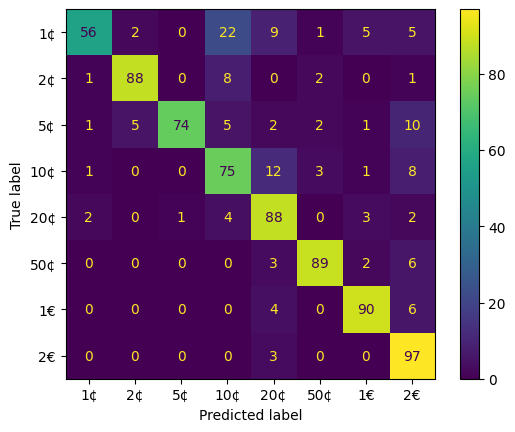

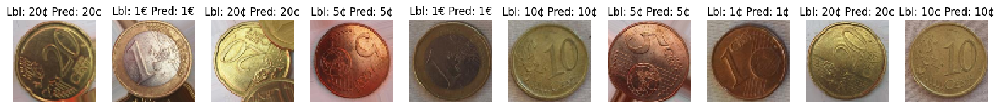

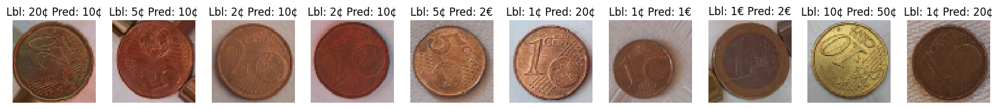

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_HOG],
    classifier=logistic_regression
)

### **HOG + Random Forest**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_HOG],
    classifier=random_forest
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.98      0.93      0.96       197
          2¢       0.86      0.93      0.90       197
          5¢       0.93      0.90      0.91       196
         10¢       0.95      0.88      0.91       197
         20¢       0.90      0.89      0.90       197
         50¢       0.91      0.98      0.94       197
          1€       0.96      0.96      0.96       196
          2€       0.97      0.96      0.97       197

    accuracy                           0.93      1574
   macro avg       0.93      0.93      0.93      1574
weighted avg       0.93      0.93      0.93      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.95      0.90      0.92       197
          2¢       0.87      0.95      0.91       196
          5¢       0.91      0.92      0.92       197
         10¢       0.89      0.89      0.89       196
         20¢    


Classification accuracy: 81.12%
Final accuracy (considering the segmentation error): 72.67%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.87      0.69      0.77       100
          2¢       0.91      0.86      0.88       100
          5¢       0.83      0.77      0.80       100
         10¢       0.80      0.69      0.74       100
         20¢       0.70      0.85      0.77       100
         50¢       0.85      0.89      0.87       100
          1€       0.86      0.77      0.81       100
          2€       0.75      0.97      0.84       100

    accuracy                           0.81       800
   macro avg       0.82      0.81      0.81       800
weighted avg       0.82      0.81      0.81       800



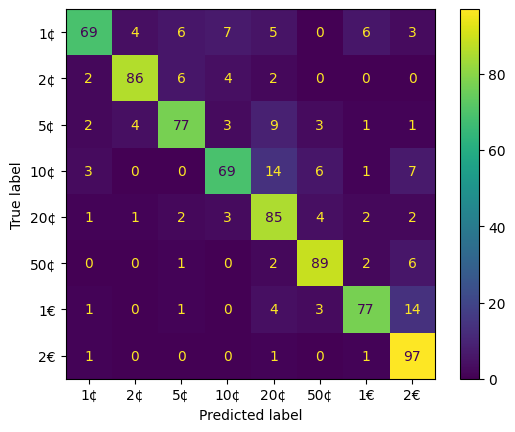

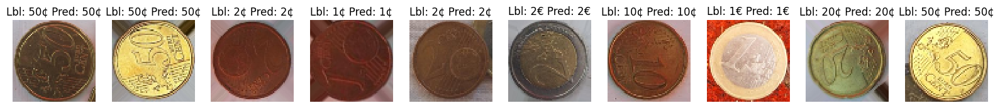

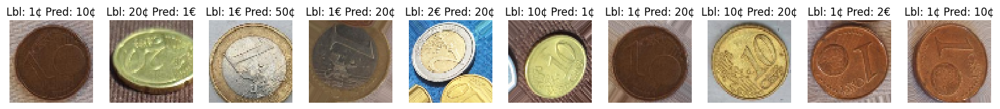

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_HOG],
    classifier=random_forest
)

### **LBP + Logistic Regression**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_LBP],
    classifier=logistic_regression
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.31      0.21      0.25       197
          2¢       0.36      0.36      0.36       197
          5¢       0.36      0.10      0.16       196
         10¢       0.21      0.14      0.17       197
         20¢       0.50      0.01      0.01       197
         50¢       0.23      0.58      0.33       197
          1€       0.26      0.62      0.37       196
          2€       0.50      0.27      0.35       197

    accuracy                           0.29      1574
   macro avg       0.34      0.29      0.25      1574
weighted avg       0.34      0.29      0.25      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.28      0.19      0.22       197
          2¢       0.31      0.38      0.34       196
          5¢       0.39      0.04      0.07       197
         10¢       0.27      0.19      0.23       196
         20¢    


Classification accuracy: 22.88%
Final accuracy (considering the segmentation error): 20.49%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.23      0.09      0.13       100
          2¢       0.24      0.16      0.19       100
          5¢       0.00      0.00      0.00       100
         10¢       0.30      0.19      0.23       100
         20¢       0.00      0.00      0.00       100
         50¢       0.17      0.45      0.24       100
          1€       0.24      0.54      0.33       100
          2€       0.31      0.40      0.35       100

    accuracy                           0.23       800
   macro avg       0.19      0.23      0.19       800
weighted avg       0.19      0.23      0.19       800



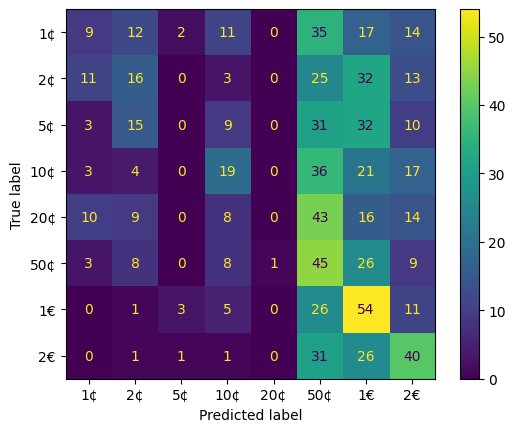

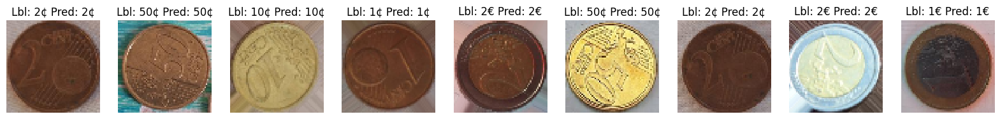

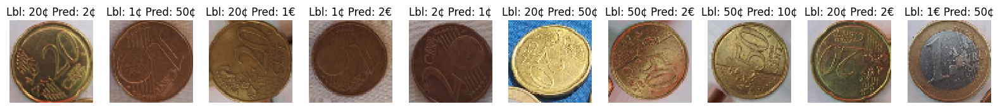

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_LBP],
    classifier=logistic_regression
)

### **LBP + Random Forest**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_LBP],
    classifier=random_forest
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.57      0.64      0.60       197
          2¢       0.57      0.60      0.58       197
          5¢       0.54      0.58      0.56       196
         10¢       0.57      0.55      0.56       197
         20¢       0.48      0.36      0.41       197
         50¢       0.64      0.55      0.59       197
          1€       0.62      0.68      0.65       196
          2€       0.63      0.69      0.66       197

    accuracy                           0.58      1574
   macro avg       0.58      0.58      0.58      1574
weighted avg       0.58      0.58      0.58      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.56      0.68      0.62       197
          2¢       0.50      0.47      0.49       196
          5¢       0.56      0.45      0.50       197
         10¢       0.53      0.61      0.57       196
         20¢    


Classification accuracy: 46.12%
Final accuracy (considering the segmentation error): 41.32%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.54      0.43      0.48       100
          2¢       0.50      0.31      0.38       100
          5¢       0.51      0.34      0.41       100
         10¢       0.46      0.51      0.48       100
         20¢       0.34      0.32      0.33       100
         50¢       0.64      0.49      0.55       100
          1€       0.45      0.64      0.53       100
          2€       0.39      0.65      0.49       100

    accuracy                           0.46       800
   macro avg       0.48      0.46      0.46       800
weighted avg       0.48      0.46      0.46       800



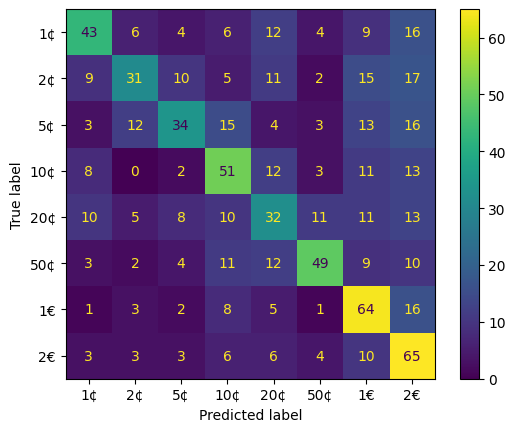

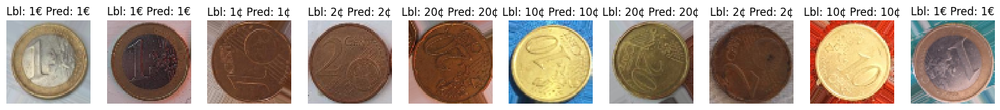

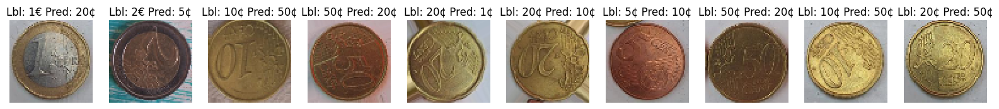

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_LBP],
    classifier=random_forest
)

### **HOG and LBP + Logistic Regression**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_HOG, features_extractor_LBP],
    classifier=logistic_regression
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.99      0.95      0.97       197
          2¢       0.95      0.97      0.96       197
          5¢       0.97      0.96      0.97       196
         10¢       0.91      0.96      0.94       197
         20¢       0.94      0.93      0.94       197
         50¢       0.97      0.98      0.98       197
          1€       0.98      0.98      0.98       196
          2€       1.00      0.96      0.98       197

    accuracy                           0.97      1574
   macro avg       0.97      0.97      0.97      1574
weighted avg       0.97      0.97      0.97      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.96      0.96      0.96       197
          2¢       0.95      0.96      0.96       196
          5¢       0.97      0.97      0.97       197
         10¢       0.93      0.90      0.91       196
         20¢    


Classification accuracy: 82.38%
Final accuracy (considering the segmentation error): 73.79%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.92      0.58      0.71       100
          2¢       0.92      0.89      0.90       100
          5¢       0.99      0.74      0.85       100
         10¢       0.67      0.74      0.70       100
         20¢       0.72      0.88      0.79       100
         50¢       0.93      0.89      0.91       100
          1€       0.87      0.90      0.89       100
          2€       0.72      0.97      0.83       100

    accuracy                           0.82       800
   macro avg       0.84      0.82      0.82       800
weighted avg       0.84      0.82      0.82       800



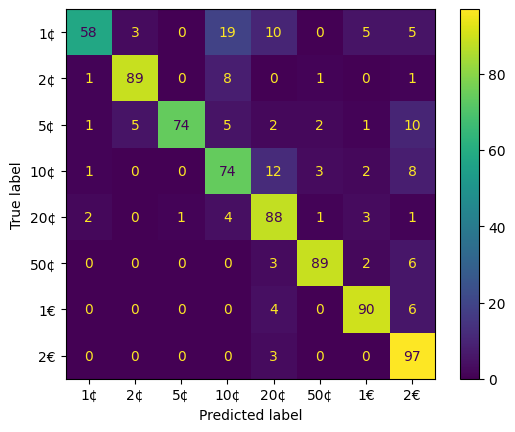

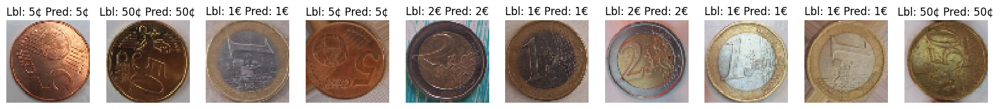

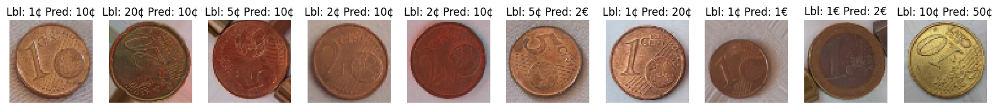

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_HOG, features_extractor_LBP],
    classifier=logistic_regression
)

### **HOG and LBP + Random Forest**

In [ ]:
shallow_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    features_extractors=[features_extractor_HOG, features_extractor_LBP],
    classifier=random_forest
)


Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.95      0.93      0.94       197
          2¢       0.86      0.93      0.90       197
          5¢       0.93      0.91      0.92       196
         10¢       0.91      0.93      0.92       197
         20¢       0.95      0.82      0.88       197
         50¢       0.92      0.98      0.95       197
          1€       0.96      0.95      0.96       196
          2€       0.96      0.97      0.97       197

    accuracy                           0.93      1574
   macro avg       0.93      0.93      0.93      1574
weighted avg       0.93      0.93      0.93      1574


Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.94      0.93      0.94       197
          2¢       0.86      0.94      0.90       196
          5¢       0.94      0.91      0.93       197
         10¢       0.92      0.90      0.91       196
         20¢    


Classification accuracy: 82.62%
Final accuracy (considering the segmentation error): 74.02%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.92      0.73      0.82       100
          2¢       0.86      0.91      0.88       100
          5¢       0.90      0.69      0.78       100
         10¢       0.80      0.82      0.81       100
         20¢       0.71      0.89      0.79       100
         50¢       0.88      0.91      0.90       100
          1€       0.87      0.69      0.77       100
          2€       0.76      0.97      0.85       100

    accuracy                           0.83       800
   macro avg       0.84      0.83      0.82       800
weighted avg       0.84      0.83      0.82       800



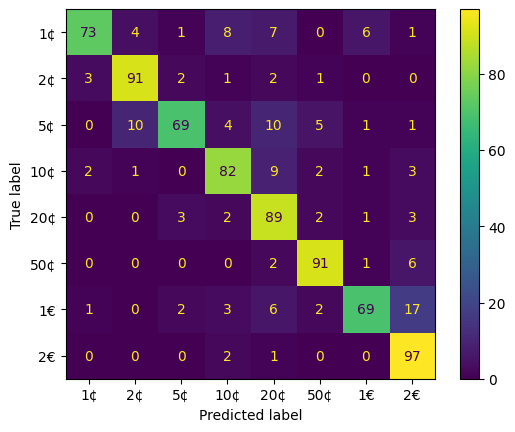

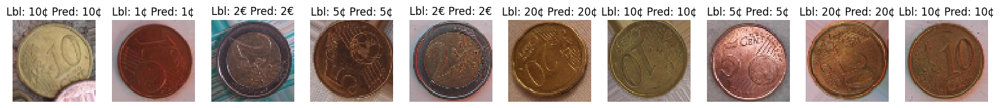

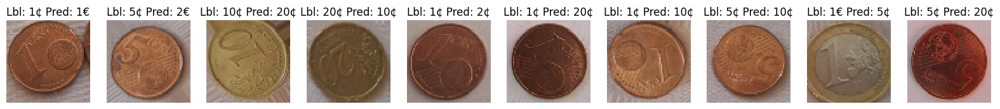

In [ ]:
shallow_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    classes=list(classes.values()),
    features_extractors=[features_extractor_HOG, features_extractor_LBP],
    classifier=random_forest
)

## **Deep Learning**





* Evaluate at least two CNN architectures:
One architecture designed from scratch by the team.
One consolidated state-of-the-art architecture (e.g., MobileNet, ResNet, EfficientNet).

* Perform training, validation, and fine-tuning with appropriate regularization and optimization strategies.

* Ablation: Compare CNN performance when using segmented coins versus original images.

* Evaluation Protocol: Use K-FOLD cross-validation with K=3 to ensure robust evaluation and generalization of the models. For the test phase, only real data must be used.

In [ ]:
# Training parameters
epochs = 30
batch_size = 128
callbacks = [
    tf.keras.callbacks.EarlyStopping(
        monitor="val_accuracy",
        patience=15,
        restore_best_weights=True,
        verbose=1
    ),
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor="val_loss",
        factor=0.6,
        patience=2,
        min_lr=1e-7,
        verbose=0
    )
]

In [ ]:
# Models parameters
dropout = 0.3
regularization_factor = 1e-4
learning_rate = 1e-3
data_augmentation = tf.keras.Sequential(
    [
        tf.keras.layers.RandomRotation(0.1),
    ]
)

### **Basic functions**

In [ ]:
def deep_classify(X, y, classes, k_splits, val_size, deep_model, epochs, batch_size, callbacks):
    # Define KFold
    kfold = sklearn.model_selection.StratifiedKFold(n_splits=k_splits, shuffle=True, random_state=1)

    reports = []

    for fold, (train_idx, test_idx) in enumerate(kfold.split(X, y)):
        # Split data
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        # Get validation
        X_train, X_val, y_train, y_val = sklearn.model_selection.train_test_split(
            X_train, y_train, test_size=val_size, shuffle=True, random_state=1
        )

        # Train model
        model = deep_model()
        history = model.fit(
            X_train,
            y_train,
            epochs=epochs,
            batch_size=batch_size,
            validation_data=(X_val, y_val),
            callbacks=callbacks
        )

        # Printing history
        fig, ax = plt.subplots(2, 1, figsize=(6, 6))

        # Training Loss
        ax[0].plot(history.history["loss"], color="r", label="Training Loss")
        ax[0].plot(history.history["val_loss"], color="b", label="Validation Loss")
        ax[0].set_title("Loss")
        ax[0].set_xlabel("Epoch")
        ax[0].set_ylabel("Loss")
        ax[0].legend()

        # Training Accuracy
        ax[1].plot(history.history["accuracy"], color="r", label="Training Accuracy")
        ax[1].plot(history.history["val_accuracy"], color="b", label="Validation Accuracy")
        ax[1].set_title("Accuracy")
        ax[1].set_xlabel("Epoch")
        ax[1].set_ylabel("Accuracy")
        ax[1].legend()

        plt.tight_layout()
        plt.show()

        # Predict & evaluate
        y_pred = model.predict(X_test)
        y_pred = np.argmax(y_pred, axis = 1)

        # Generate classification report as dict
        report = sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, output_dict=True, zero_division=0)
        reports.append(report)

        print(f"\nFold {fold + 1} classification report:")
        print(sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, zero_division=0))

    # Compute mean scores across folds
    mean_report = {}
    for key in reports[0].keys():  # Iterate over classes + "accuracy", "macro avg", "weighted avg"
        if key == "accuracy":
            mean_report[key] = {
                "precision": "",
                "recall": "",
                "f1-score": f"{np.mean([r[key] for r in reports]):.2f}",
                "support": f"{int(np.mean([r['macro avg']['support'] for r in reports]))}"
            }
        else:
            mean_report[key] = {}
            for metric in reports[0][key]:
                result = np.mean([r[key][metric] for r in reports])
                mean_report[key][metric] = f"{result:.2f}" if metric != "support" else f"{int(result)}"

    # Format like original classification_report
    print("\nMean classification report across folds:")
    print("=" * 56)
    headers = ["precision", "recall", "f1-score", "support"]
    row_fmt = "{:>12} {:>10} {:>10} {:>10} {:>10}".format("", *headers)
    print(row_fmt)

    for key, metrics in mean_report.items():
        if key in ["accuracy", "macro avg", "weighted avg"]:
            if key == "accuracy":
                print()
            print(f"{key:>12} ", end="")
        else:
            print(f"{key:>12} ", end="")
        print("{:10} {:>10} {:>10} {:>10}".format(
            metrics["precision"], metrics["recall"], metrics["f1-score"], metrics["support"]
        ))

In [ ]:
def deep_evaluate(X_train, y_train, X_test, y_test, val_size, classes, deep_model, epochs, batch_size, callbacks):
    # Split train and validation
    X_train, X_val, y_train, y_val = sklearn.model_selection.train_test_split(
        X_train, y_train, test_size=val_size, shuffle=True, random_state=1
    )

    # Train model
    model = deep_model()
    history = model.fit(
        X_train,
        y_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(X_val, y_val),
        callbacks=callbacks
    )

    # Printing history
    fig, ax = plt.subplots(2, 1, figsize=(6, 6))

    # Training Loss
    ax[0].plot(history.history["loss"], color="r", label="Training Loss")
    ax[0].plot(history.history["val_loss"], color="b", label="Validation Loss")
    ax[0].set_title("Loss")
    ax[0].set_xlabel("Epoch")
    ax[0].set_ylabel("Loss")
    ax[0].legend()

    # Training Accuracy
    ax[1].plot(history.history["accuracy"], color="r", label="Training Accuracy")
    ax[1].plot(history.history["val_accuracy"], color="b", label="Validation Accuracy")
    ax[1].set_title("Accuracy")
    ax[1].set_xlabel("Epoch")
    ax[1].set_ylabel("Accuracy")
    ax[1].legend()

    plt.tight_layout()
    plt.show()

    # Predict on test set
    y_pred = model.predict(X_test)
    y_pred = np.argmax(y_pred, axis = 1)

    # Accuracy
    acc = sklearn.metrics.accuracy_score(y_test, y_pred)
    print(f"\nClassification accuracy: {100 * acc:.2f}%")
    print(f"Final accuracy (considering the segmentation error): {100 * calc_final_acc(acc):.2f}%")

    # Classification report
    print("\nClassification Report on Test Set:")
    print(sklearn.metrics.classification_report(y_test, y_pred, target_names=classes, zero_division=0))

    # Confusion matrix
    sklearn.metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_pred, display_labels=classes)
    plt.show()

    # Show correct and wrong predictions
    index = np.random.randint(len(y_test))
    amount = 10
    diff = y_test - y_pred

    masks = [np.where(diff == 0)[0], np.where(diff != 0)[0]]

    for mask in masks:
        valid_indices = mask[mask >= index][:amount]

        _, axes = plt.subplots(nrows=1, ncols=len(valid_indices), figsize=(20, 10))

        if len(valid_indices) == 1:
            axes = [axes]

        for ax, idx in zip(axes, valid_indices):
            ax.set_axis_off()
            ax.imshow(X_test[idx], interpolation="nearest")
            ax.set_title(f"Lbl: {classes[y_test[idx]]} Pred: {classes[y_pred[idx]]}")

    plt.show()

### **Custom CNN**

In [ ]:
# Define deep model
def cnn():
    model = tf.keras.models.Sequential([
        # Input
        tf.keras.layers.Input(shape=input_shape),

        # Data augmentation
        data_augmentation,

        # Conv block 1
        tf.keras.layers.Conv2D(32, (1, 1), padding="same", kernel_initializer="glorot_uniform"), # bottleneck
        tf.keras.layers.Conv2D(32, (3, 3), padding="same", kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.Conv2D(32, (3, 3), padding="same", kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.MaxPooling2D((2, 2)),

        # Conv block 2
        tf.keras.layers.Conv2D(64, (1, 1), padding="same", kernel_initializer="glorot_uniform"), # bottleneck
        tf.keras.layers.Conv2D(64, (3, 3), padding="same", kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.Conv2D(64, (3, 3), padding="same", kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.MaxPooling2D((2, 2)),

        # Conv block last
        tf.keras.layers.Conv2D(128, (1, 1), padding="same", kernel_regularizer=tf.keras.regularizers.l2(regularization_factor), kernel_initializer="glorot_uniform"), # bottleneck
        tf.keras.layers.Conv2D(128, (3, 3), padding="same", kernel_regularizer=tf.keras.regularizers.l2(regularization_factor), kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.Conv2D(128, (3, 3), padding="same", kernel_regularizer=tf.keras.regularizers.l2(regularization_factor), kernel_initializer="glorot_uniform"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Activation("relu"),
        tf.keras.layers.MaxPooling2D((2, 2)),

        # Dense
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(128, activation="relu", kernel_regularizer=tf.keras.regularizers.l2(regularization_factor)),
        tf.keras.layers.Dropout(dropout),
        tf.keras.layers.Dense(len(classes), activation="softmax"),
    ])

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"]
    )

    return model

cnn().summary()

Model: "sequential_57"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_56 (Sequential)      │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_396 (Conv2D)             │ (None, 64, 64, 32)     │           128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_397 (Conv2D)             │ (None, 64, 64, 32)     │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_264         │ (None, 64, 64, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_264 (Activation)     │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_398 (Conv2D)             │ (None, 64, 64, 32)     │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_265         │ (None, 64, 64, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_265 (Activation)     │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 32, 32, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_399 (Conv2D)             │ (None, 32, 32, 64)     │         2,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_400 (Conv2D)             │ (None, 32, 32, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_266         │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_266 (Activation)     │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_401 (Conv2D)             │ (None, 32, 32, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_267         │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_267 (Activation)     │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 16, 16, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_402 (Conv2D)             │ (None, 16, 16, 128)    │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_403 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_268         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_268 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 417,416 (1.59 MB)

 Trainable params: 416,520 (1.59 MB)

 Non-trainable params: 896 (3.50 KB)

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 9s 128ms/step - accuracy: 0.4044 - loss: 1.6642 - val_accuracy: 0.2159 - val_loss: 2.1057 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 103ms/step - accuracy: 0.5864 - loss: 1.0434 - val_accuracy: 0.2063 - val_loss: 2.6043 - learning_rate: 0.0010
Epoch 3/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.6657 - loss: 0.8464 - val_accuracy: 0.2190 - val_loss: 3.5370 - learning_rate: 0.0010
Epoch 4/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.6924 - loss: 0.7952 - val_accuracy: 0.2317 - val_loss: 3.5929 - learning_rate: 6.0000e-04
Epoch 5/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.7157 - loss: 0.6907 - val_accuracy: 0.2222 - val_loss: 3.6890 - learning_rate: 6.0000e-04
Epoch 6/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.7790 - loss: 0.5998 - val_accuracy: 0.2190 - val_loss: 4.1098 - learning_rate: 3.6000e-04
Epoch 7/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7940 - los

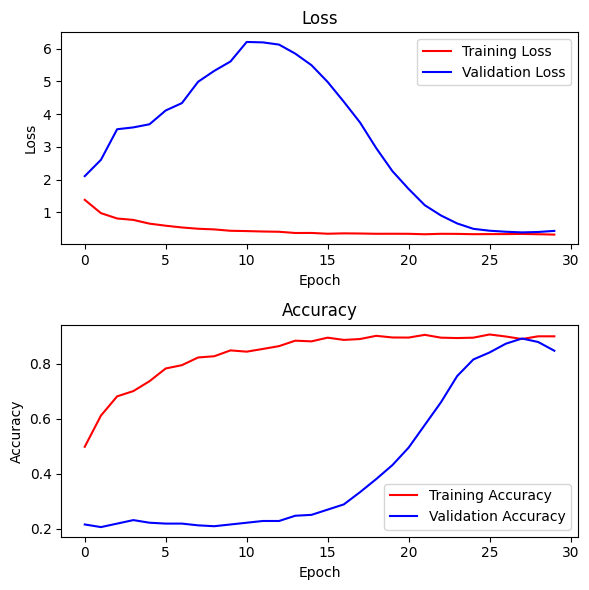

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step

Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.85      0.89      0.87       197
          2¢       0.93      0.90      0.92       197
          5¢       0.94      0.93      0.94       197
         10¢       0.92      0.82      0.87       197
         20¢       0.84      0.60      0.70       196
         50¢       0.70      0.98      0.82       196
          1€       1.00      0.99      1.00       197
          2€       0.98      0.98      0.98       197

    accuracy                           0.89      1574
   macro avg       0.90      0.89      0.89      1574
weighted avg       0.90      0.89      0.89      1574

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 34s 129ms/step - accuracy: 0.3872 - loss: 1.6911 - val_accuracy: 0.1587 - val_loss: 2.1585 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.6411 - loss: 0.9224 - val_accuracy: 0.2032 - val_loss: 2.79

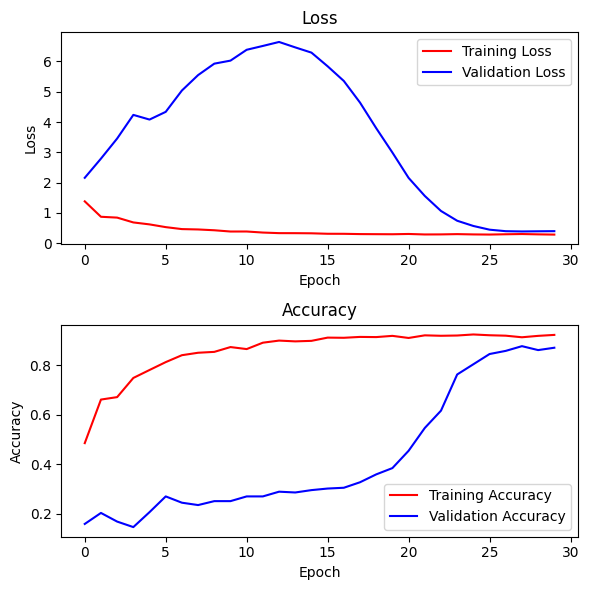

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step

Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.86      0.82      0.84       197
          2¢       0.87      0.91      0.89       197
          5¢       0.93      0.94      0.93       197
         10¢       0.98      0.84      0.90       196
         20¢       0.90      0.63      0.74       197
         50¢       0.68      0.98      0.80       197
          1€       1.00      0.99      1.00       196
          2€       0.99      0.98      0.99       196

    accuracy                           0.89      1573
   macro avg       0.90      0.89      0.89      1573
weighted avg       0.90      0.89      0.89      1573

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 9s 132ms/step - accuracy: 0.4225 - loss: 1.5579 - val_accuracy: 0.1175 - val_loss: 2.2307 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.6099 - loss: 1.0006 - val_accuracy: 0.0571 - val_loss: 3.201

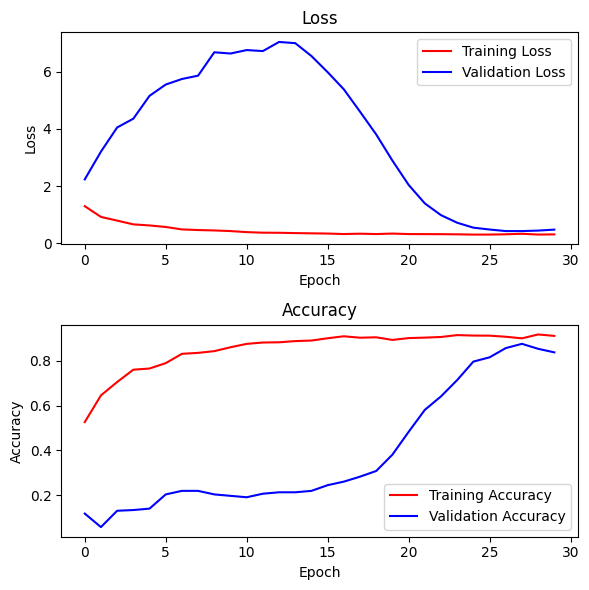

50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step

Fold 3 classification report:
              precision    recall  f1-score   support

          1¢       0.79      0.70      0.74       196
          2¢       0.80      0.88      0.84       196
          5¢       0.91      0.90      0.91       196
         10¢       0.97      0.69      0.80       197
         20¢       0.84      0.65      0.73       197
         50¢       0.63      0.98      0.77       197
          1€       0.99      0.99      0.99       197
          2€       1.00      0.97      0.99       197

    accuracy                           0.85      1573
   macro avg       0.87      0.85      0.85      1573
weighted avg       0.87      0.85      0.85      1573


Mean classification report across folds:
              precision     recall   f1-score    support
          1¢ 0.83             0.80       0.82        196
          2¢ 0.87             0.90       0.88        196
          5¢ 0.93             0.93       0.93        196
        

In [ ]:
deep_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    val_size=0.1,
    deep_model=cnn,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=callbacks
)

Epoch 1/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 10s 124ms/step - accuracy: 0.4165 - loss: 1.6352 - val_accuracy: 0.1589 - val_loss: 2.2871 - learning_rate: 0.0010
Epoch 2/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.6432 - loss: 0.9161 - val_accuracy: 0.2182 - val_loss: 3.4090 - learning_rate: 0.0010
Epoch 3/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.7075 - loss: 0.7521 - val_accuracy: 0.1886 - val_loss: 4.7541 - learning_rate: 0.0010
Epoch 4/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step - accuracy: 0.7514 - loss: 0.6806 - val_accuracy: 0.2309 - val_loss: 5.1054 - learning_rate: 6.0000e-04
Epoch 5/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8076 - loss: 0.5286 - val_accuracy: 0.2161 - val_loss: 6.4416 - learning_rate: 6.0000e-04
Epoch 6/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.8338 - loss: 0.4653 - val_accuracy: 0.2203 - val_loss: 6.9604 - learning_rate: 3.6000e-04
Epoch 7/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step - accuracy: 0.8464 - lo

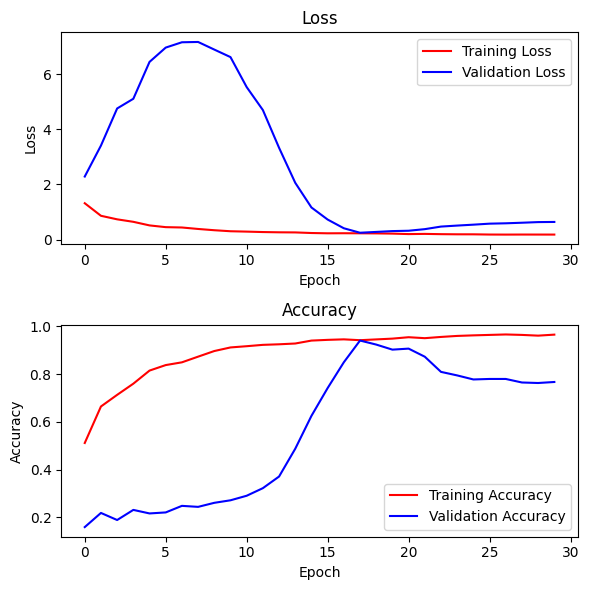

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step

Classification accuracy: 88.88%
Final accuracy (considering the segmentation error): 79.62%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.90      0.72      0.80       100
          2¢       0.88      0.94      0.91       100
          5¢       0.87      0.96      0.91       100
         10¢       0.98      0.80      0.88       100
         20¢       0.79      0.81      0.80       100
         50¢       0.83      0.95      0.88       100
          1€       0.94      0.97      0.96       100
          2€       0.95      0.96      0.96       100

    accuracy                           0.89       800
   macro avg       0.89      0.89      0.89       800
weighted avg       0.89      0.89      0.89       800



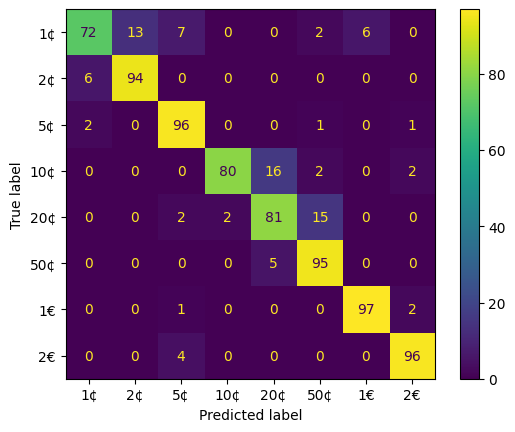

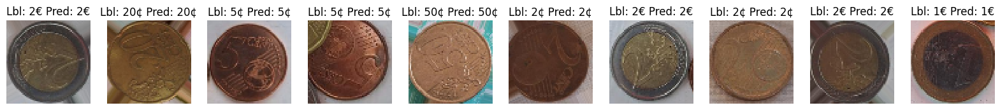

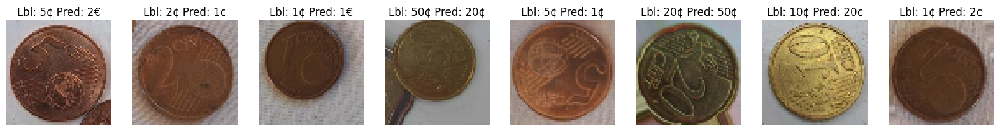

In [ ]:
deep_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    val_size=0.1,
    classes=list(classes.values()),
    deep_model=cnn,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=callbacks
)

### **EfficientNet**

In [ ]:
# Define deep model
def efficientnet():
    # Loading EfficientNet
    base_model = tf.keras.applications.EfficientNetB0(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=input_shape
    )

    # Create the model
    inputs = tf.keras.Input(shape=input_shape)
    x = data_augmentation(inputs)
    x = tf.keras.applications.efficientnet.preprocess_input(x * 255.0)
    x = base_model(x, training=False)
    # x = tf.keras.layers.GlobalAveragePooling2D()(x)
    x = tf.keras.layers.Dense(128, activation="relu", kernel_regularizer=tf.keras.regularizers.l2(regularization_factor))(x)
    x = tf.keras.layers.Dropout(dropout)(x)
    outputs = tf.keras.layers.Dense(len(classes), activation="softmax")(x)

    model = tf.keras.models.Model(inputs, outputs)

    # Freeze EfficientNet
    for layer in base_model.layers:
        layer.trainable = False

    # Unfreeze last few layers of EfficientNet (fine-tuning)
    for layer in base_model.layers[-3:]:
        layer.trainable = True

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"]
    )

    return model

tf.keras.applications.EfficientNetB0(include_top=False).summary()
efficientnet().summary()

Model: "efficientnetb0"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_75      │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_16        │ (None, None,      │          0 │ input_layer_75[0… │
│ (Rescaling)         │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization_8     │ (None, None,      │          7 │ rescaling_16[0][… │
│ (Normalization)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_17        │ (None, None,      │          0 │ normalization_8[… │
│ (Rescaling)         │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, None,      │          0 │ rescaling_17[0][… │
│ (ZeroPadding2D)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, None,      │        864 │ stem_conv_pad[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, None,      │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, None,      │          0 │ stem_bn[0][0]     │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, None,      │        288 │ stem_activation[… │
│ (DepthwiseConv2D)   │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, None,      │        128 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, None,      │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 32)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 32)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 8)   │        264 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 32)  │        288 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, None,      │          0 │ block1a_activati… │
│ (Multiply)          │ None, 32)         │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, None,      │        512 │ block1a_se_excit

 Total params: 4,049,571 (15.45 MB)

 Trainable params: 4,007,548 (15.29 MB)

 Non-trainable params: 42,023 (164.16 KB)

Model: "functional_67"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_77 (InputLayer)     │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_56 (Sequential)      │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multiply_5 (Multiply)           │ (None, 64, 64, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 1280)           │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_54 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 8)              │         1,032 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,214,571 (16.08 MB)

 Trainable params: 167,560 (654.53 KB)

 Non-trainable params: 4,047,011 (15.44 MB)

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 16s 251ms/step - accuracy: 0.4665 - loss: 1.5052 - val_accuracy: 0.5175 - val_loss: 1.3563 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.8489 - loss: 0.4797 - val_accuracy: 0.6190 - val_loss: 1.0152 - learning_rate: 0.0010
Epoch 3/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.9012 - loss: 0.3257 - val_accuracy: 0.7873 - val_loss: 0.7112 - learning_rate: 0.0010
Epoch 4/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step - accuracy: 0.9317 - loss: 0.2463 - val_accuracy: 0.8413 - val_loss: 0.5742 - learning_rate: 0.0010
Epoch 5/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.9436 - loss: 0.2053 - val_accuracy: 0.8698 - val_loss: 0.4361 - learning_rate: 0.0010
Epoch 6/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.9543 - loss: 0.1830 - val_accuracy: 0.9238 - val_loss: 0.3145 - learning_rate: 0.0010
Epoch 7/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - accuracy: 0.9571 - loss: 0.1751 - val_a

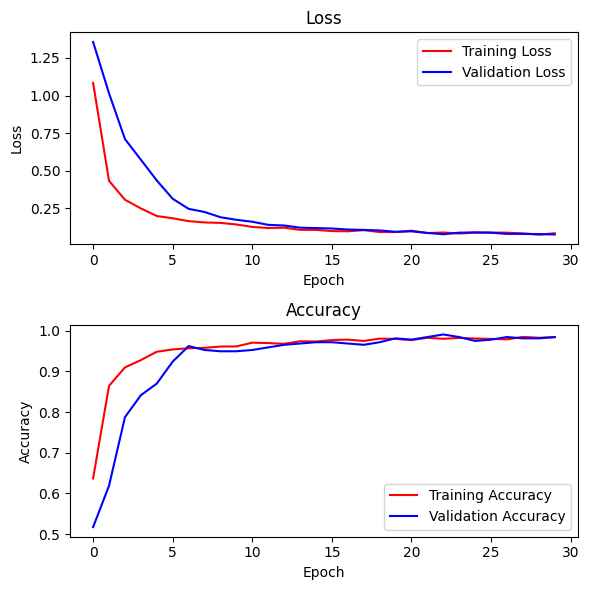

50/50 ━━━━━━━━━━━━━━━━━━━━ 6s 66ms/step

Fold 1 classification report:
              precision    recall  f1-score   support

          1¢       0.98      0.99      0.98       197
          2¢       0.98      0.97      0.98       197
          5¢       0.99      1.00      1.00       197
         10¢       0.97      0.98      0.98       197
         20¢       0.98      0.91      0.95       196
         50¢       0.95      1.00      0.97       196
          1€       1.00      1.00      1.00       197
          2€       1.00      1.00      1.00       197

    accuracy                           0.98      1574
   macro avg       0.98      0.98      0.98      1574
weighted avg       0.98      0.98      0.98      1574

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 17s 180ms/step - accuracy: 0.4771 - loss: 1.5066 - val_accuracy: 0.4794 - val_loss: 1.3425 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.8589 - loss: 0.4551 - val_accuracy: 0.6444 - val_loss: 0.966

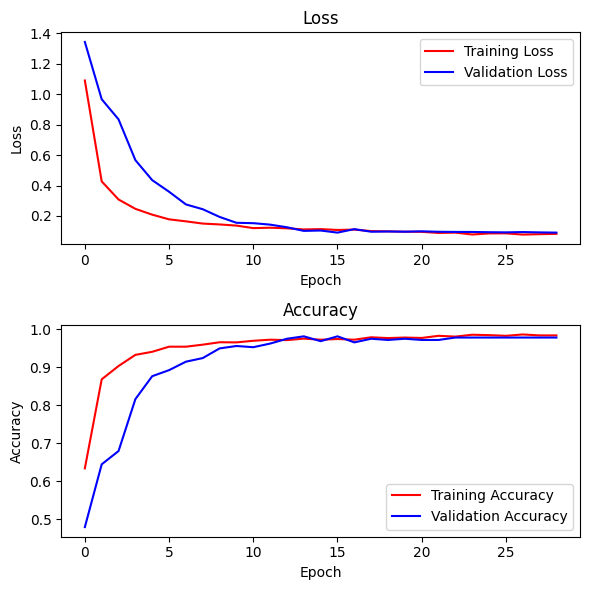

50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step

Fold 2 classification report:
              precision    recall  f1-score   support

          1¢       0.97      0.99      0.98       197
          2¢       0.97      0.99      0.98       197
          5¢       1.00      0.97      0.99       197
         10¢       1.00      0.99      1.00       196
         20¢       0.99      0.85      0.92       197
         50¢       0.88      0.99      0.93       197
          1€       1.00      0.99      1.00       196
          2€       0.99      1.00      0.99       196

    accuracy                           0.97      1573
   macro avg       0.98      0.97      0.97      1573
weighted avg       0.98      0.97      0.97      1573

Epoch 1/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 14s 165ms/step - accuracy: 0.4369 - loss: 1.5827 - val_accuracy: 0.4032 - val_loss: 1.3994 - learning_rate: 0.0010
Epoch 2/30
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step - accuracy: 0.8537 - loss: 0.4580 - val_accuracy: 0.6413 - val_loss: 0.949

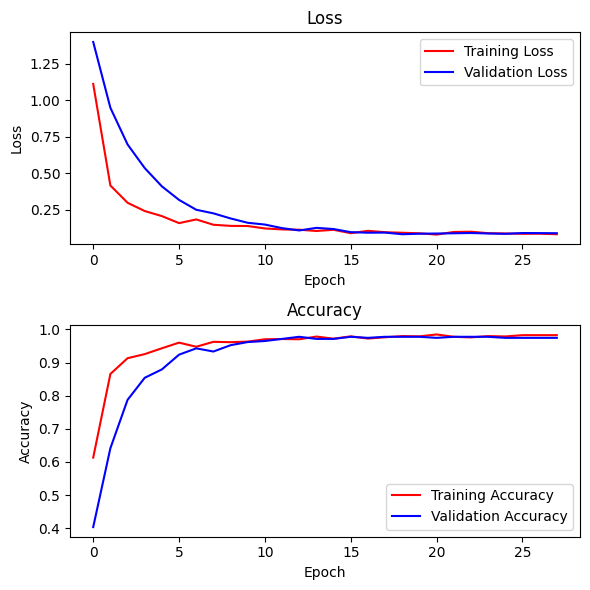

50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 66ms/step

Fold 3 classification report:
              precision    recall  f1-score   support

          1¢       0.96      0.96      0.96       196
          2¢       0.97      0.98      0.98       196
          5¢       0.99      0.98      0.99       196
         10¢       0.98      0.98      0.98       197
         20¢       0.96      0.93      0.95       197
         50¢       0.95      0.97      0.96       197
          1€       1.00      1.00      1.00       197
          2€       1.00      1.00      1.00       197

    accuracy                           0.98      1573
   macro avg       0.98      0.98      0.98      1573
weighted avg       0.98      0.98      0.98      1573


Mean classification report across folds:
              precision     recall   f1-score    support
          1¢ 0.97             0.98       0.98        196
          2¢ 0.98             0.98       0.98        196
          5¢ 1.00             0.99       0.99        196
        

In [ ]:
deep_classify(
    data_X,
    data_y,
    classes=list(classes.values()),
    k_splits=3,
    val_size=0.1,
    deep_model=efficientnet,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=callbacks
)

Epoch 1/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 15s 138ms/step - accuracy: 0.5308 - loss: 1.3650 - val_accuracy: 0.5826 - val_loss: 1.0398 - learning_rate: 0.0010
Epoch 2/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - accuracy: 0.8852 - loss: 0.3501 - val_accuracy: 0.7818 - val_loss: 0.6653 - learning_rate: 0.0010
Epoch 3/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.9195 - loss: 0.2685 - val_accuracy: 0.9089 - val_loss: 0.4096 - learning_rate: 0.0010
Epoch 4/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - accuracy: 0.9426 - loss: 0.2071 - val_accuracy: 0.9386 - val_loss: 0.2855 - learning_rate: 0.0010
Epoch 5/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.9529 - loss: 0.1726 - val_accuracy: 0.9534 - val_loss: 0.2045 - learning_rate: 0.0010
Epoch 6/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step - accuracy: 0.9606 - loss: 0.1590 - val_accuracy: 0.9661 - val_loss: 0.1549 - learning_rate: 0.0010
Epoch 7/30
34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - accuracy: 0.9651 - loss: 0.1303 - val_a

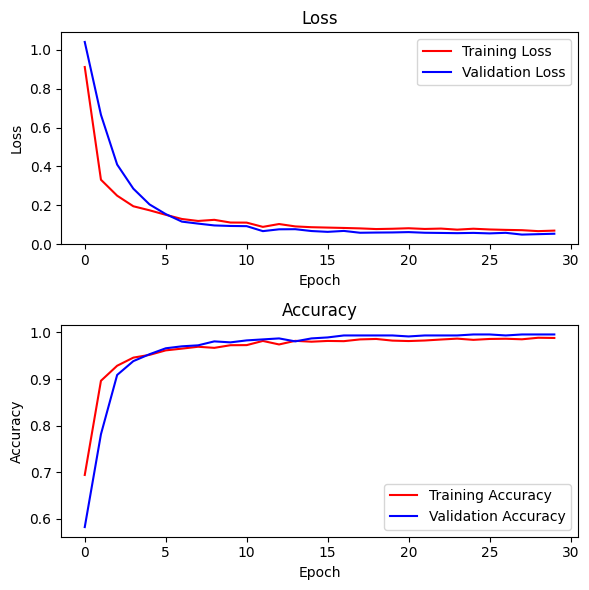

25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step

Classification accuracy: 97.75%
Final accuracy (considering the segmentation error): 87.57%

Classification Report on Test Set:
              precision    recall  f1-score   support

          1¢       0.98      0.93      0.95       100
          2¢       0.95      0.99      0.97       100
          5¢       0.99      0.98      0.98       100
         10¢       1.00      0.98      0.99       100
         20¢       0.99      0.96      0.97       100
         50¢       0.94      0.99      0.97       100
          1€       1.00      0.99      0.99       100
          2€       0.97      1.00      0.99       100

    accuracy                           0.98       800
   macro avg       0.98      0.98      0.98       800
weighted avg       0.98      0.98      0.98       800



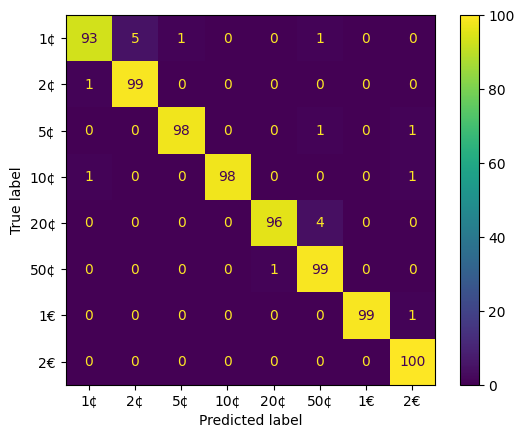

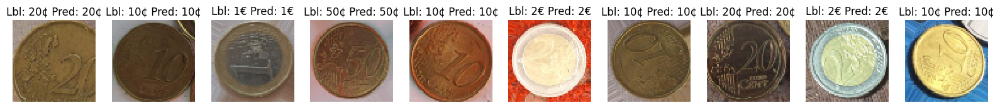

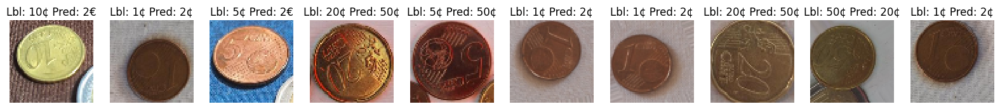

In [ ]:
deep_evaluate(
    X_train=data_X,
    y_train=data_y,
    X_test=seg_X,
    y_test=seg_y,
    val_size=0.1,
    classes=list(classes.values()),
    deep_model=efficientnet,
    epochs=epochs,
    batch_size=batch_size,
    callbacks=callbacks
)

# **Critical Analysis**



This work addressed the problem of coin recognition by comparing shallow approaches based on handcrafted features with deep neural models. The methodology followed two main strategies. On one hand, shallow models relied on feature extraction techniques such as Histogram of Oriented Gradients (HOG) and Local Binary Patterns (LBP), which were subsequently classified using algorithms like Logistic Regression and Random Forest. On the other hand, deep learning solutions included a convolutional neural network designed from scratch and a transfer learning strategy with EfficientNet, pre-trained on ImageNet and fine-tuned for the dataset. In both cases, evaluation was conducted through stratified cross-validation, and additional tests were performed on segmented coin images obtained using image processing techniques in order to approximate real-world scenarios.

**During the coin segmentation stage, an error rate of 10.42% was observed.** Of the 336 coins expected to be detected, only 327 were correctly segmented and matched. The segmentation process also produced 26 extra detections that did not correspond to real coins (false positives) while failing to identify 9 actual coins present in the images (false negatives). These inaccuracies illustrate the inherent limitations of relying solely on image processing techniques for segmentation, as errors introduced at this stage propagate to the classification step and directly affect the overall system performance.

**Among the shallow methods, the combination of HOG and LBP features provided the most competitive results** for both Logistic Regression and Random Forest (83-84% in classification). Interestingly, the use of HOG alone produced results very close to the combined approach (\~1–2% difference), indicating that coin classification is primarily a shape-based problem.

In contrast, the deep learning models consistently outperformed the shallow approaches. The custom CNN performed better than the shallow approaches, with an accuracy increase of approximately 4-5% in classfication. And, finally, **the EfficientNet model outperformed all other approaches, achieving 97.8% accuracy in classification tasks and a final accuracy of 87.6% when segmentation errors were considered.**

The implementation of these approaches was not without challenges. Shallow methods required careful feature engineering, while deep networks demanded greater computational power and were more prone to overfitting given the relatively limited dataset. Regularization strategies, dropout layers, and early stopping were essential to stabilize training, while data augmentation played a decisive role in improving performance. By introducing random transformations such as rotations and brightness variations, the models were exposed to a wider range of visual conditions, which enhanced their generalization ability and significantly reduced overfitting risks.

The comparison between shallow and deep approaches underscores their different areas of applicability. Shallow models, although less accurate, may still be suitable in resource-constrained environments where computational efficiency takes precedence over precision, such as embedded systems with limited processing capacity. Deep networks, conversely, are better suited for contexts where accuracy and robustness are critical, provided sufficient computational resources are available. In particular, transfer learning with EfficientNet demonstrated a strong capacity to adapt to the coin recognition domain while maintaining high performance, reinforcing the advantages of leveraging large-scale pre-trained models.

Despite the promising results, certain limitations remain. **The relatively small dataset constrained the potential of deep architectures, which generally benefit from larger and more diverse training sets. When a dataset is larger, more cases are covered and the risk of overfitting is reduced, as the model is exposed to a broader variety of examples.** Moreover, segmentation errors introduced at the preprocessing stage directly impacted the final classification results, suggesting that more sophisticated detection and segmentation pipelines could further enhance recognition performance.

**In conclusion, the experiments confirmed that deep learning approaches achieved superior performance compared to shallow methods in the task of coin recognition.** EfficientNet, in particular, stood out as the best-performing model, combining the strengths of transfer learning with data augmentation. While shallow methods remain a viable option in scenarios with low computational resources, deep learning provides a more accurate and reliable solution for real-world applications. Future research should explore other architectures, such as MobileNet or Vision Transformers, and integrate them with deep learning-based segmentation strategies. Such extensions could further improve the accuracy and the practical applicability of automated coin recognition systems.